# ANALYSIS SUMMARY 
#### Data has been collected from Aug 23rd 10 AM  - Aug 25th 1PM , Data de-duplication is done and the following Analysis have been done :
   
    1.  The available vehicles and missing vehicles have been observed
    2.  The number of Operational and Non-Operational Ambulances and Motorcycle Ambulances
    3.  Vehicles with highest and least number of publishes are observed
    4.  The number of Cases handled by each vehicle is observed
    5.  Publish Interval is observed at individual vehicle level when that vehicle is on duty and off duty 
    6.  OFF-Duty Locations of the vehicles are visualised
    7.  Data with no location information for vehicles ON-Duty
    8.  Day wise vehicle operations
    9.  Plot showing Region of travel of all available vehicles
    10. Visualizing the Route travelled by a particular vehicle
    11. Visualising region of travel of Ambulances and Motor Cycle ambulances
    
    
    
    

In [41]:
import requests
import json
from datetime import datetime, timedelta, date
# from apscheduler.schedulers.blocking import BlockingScheduler
from pytz import timezone
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import csv
import dateutil.parser as dp
import numpy as np 
import datetime



In [42]:
import plotly.express as px
import folium
import folium.plugins


In [43]:
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

In [44]:
def checkDuplicates(df):
    d = {}
    d["Total Count"] = df.shape[0]
    d["Duplicate Count"] = df[df.duplicated()].shape[0]
    d[" Duplicate Percentage"] = round((df[df.duplicated()].shape[0]/df.shape[0])*100,2)
    if df[df.duplicated()].shape[0] != 0: 
        return "Duplicates Present ... |"+ str(d)
    else:
        return "No Duplicated Found |"+ str(d)
    

In [45]:
df = pd.read_csv("dump.csv")
df = df[df['id']!='id']
df.reset_index(inplace=True)
df.drop(['index'],axis=1, inplace=True)
df.sort_values(['observationDateTime'],ascending=False,inplace = True)
df

,id,license_plate,observationDateTime,location,emergencyVehicleType,serviceOnDuty
91183,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5256,2021-09-24T21:13:41+05:30,"{'type': 'Point', 'coordinates': [77.64991, 12...",AMBULANCE,YES
91186,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5254,2021-09-24T21:13:40+05:30,"{'type': 'Point', 'coordinates': [77.570396, 1...",AMBULANCE,YES
91181,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA40G480,2021-09-24T21:13:40+05:30,"{'type': 'Point', 'coordinates': [77.600426, 1...",AMBULANCE,YES
91175,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA40G473,2021-09-24T21:13:39+05:30,"{'type': 'Point', 'coordinates': [77.500343, 1...",AMBULANCE,NO
91176,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA02G1603,2021-09-24T21:13:39+05:30,"{'type': 'Point', 'coordinates': [77.548126, 1...",MOTORCYCLE AMBULANCE,YES
...,...,...,...,...,...,...
2,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5234,2021-09-23T16:13:02+05:30,"{'type': 'Point', 'coordinates': [77.599289, 1...",AMBULANCE,YES
1,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5040,2021-09-23T16:13:01+05:30,"{'type': 'Point', 'coordinates': [77.566528, 1...",AMBULANCE,NO
909,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5041,2021-09-23T16:09:19+05:30,"{'type': 'Point', 'coordinates': [77.589211, 1...",AMBULANCE,YES
4843,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5257,2021-09-23T15:43:32+05:30,"{'type': 'Point', 'coordinates': [77.63121, 12...",AMBULANCE,NO


In [46]:
checkDuplicates(df)

"No Duplicated Found |{'Total Count': 91189, 'Duplicate Count': 0, ' Duplicate Percentage': 0.0}"

In [47]:
### Dropping Duplicate Entries (if any) ### 

df = df.drop_duplicates()
df.reset_index(inplace=True)
df.drop(['index'], axis=1, inplace=True)
df

,id,license_plate,observationDateTime,location,emergencyVehicleType,serviceOnDuty
0,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5256,2021-09-24T21:13:41+05:30,"{'type': 'Point', 'coordinates': [77.64991, 12...",AMBULANCE,YES
1,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5254,2021-09-24T21:13:40+05:30,"{'type': 'Point', 'coordinates': [77.570396, 1...",AMBULANCE,YES
2,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA40G480,2021-09-24T21:13:40+05:30,"{'type': 'Point', 'coordinates': [77.600426, 1...",AMBULANCE,YES
3,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA40G473,2021-09-24T21:13:39+05:30,"{'type': 'Point', 'coordinates': [77.500343, 1...",AMBULANCE,NO
4,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA02G1603,2021-09-24T21:13:39+05:30,"{'type': 'Point', 'coordinates': [77.548126, 1...",MOTORCYCLE AMBULANCE,YES
...,...,...,...,...,...,...
91184,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5234,2021-09-23T16:13:02+05:30,"{'type': 'Point', 'coordinates': [77.599289, 1...",AMBULANCE,YES
91185,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5040,2021-09-23T16:13:01+05:30,"{'type': 'Point', 'coordinates': [77.566528, 1...",AMBULANCE,NO
91186,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5041,2021-09-23T16:09:19+05:30,"{'type': 'Point', 'coordinates': [77.589211, 1...",AMBULANCE,YES
91187,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5257,2021-09-23T15:43:32+05:30,"{'type': 'Point', 'coordinates': [77.63121, 12...",AMBULANCE,NO


### 1) AVAILABLE AND MISSING VEHICLES

In [48]:
L2 = ['KA40G425', 'KA40G477', 'KA40G514', 'KA40G518', 'KA40G473',
       'KA02G1602', 'KA02G1603', 'KA02G1604', 'KA02G1607', 'KA02G1614',
       'KA02G1615', 'KA02G1616', 'KA02G1617', 'KA02G1618', 'KA02G1621',
       'KA02G1622', 'KA51G5032', 'KA51G5022', 'KA51G5040', 'KA51G5028',
       'KA51G5035', 'KA51G5041', 'KA51G5030', 'KA51G5027', 'KA51G5026',
       'KA02G1605', 'KA40G480', 'KA51G5039', 'KA51G5250', 'KA51G5256',
       'KA51G5235', 'KA51G5234', 'KA51G5252', 'KA51G5231', 'KA51G5246',
       'KA51G5221', 'KA51G5240', 'KA51G5238', 'KA51G5245', 'KA51G5247',
       'KA51G5253', 'KA51G5254', 'KA51G5232', 'KA51G5223', 'KA02G1658',
       'KA02G1610', 'KA51G5257', 'KA02G1611', 'KA02G1619', 'KA02G1613',
       'KA51G5251', 'KA40G478', 'KA02G1608', 'KA02G1606', 'KA51G5230',
       'KA51G5227', 'KA40G430', 'KA51G5242']
L1 = df['license_plate'].unique()
L1.sort()
print("There are a total of ", len(L2), " vehicles.\n\n")
print("For the considered time range, the data is available for ", df['license_plate'].nunique(), " vehicles, which are:\n\n", L1 )

# print("\n The available vehicles are : \n",L1, len(L1))
### L2 is list of all 58 Vehicles ###




L2.sort()

L3 = np.setdiff1d(L2,L1)
# print("\n\nThe data for these ",len(L3)," vehicles have not been available ->")
print("\n",len(L3)," vehicles have not provided data in the considered time range  : \n\n ", L3)


There are a total of  58  vehicles.


For the considered time range, the data is available for  49  vehicles, which are:

 ['KA02G1603' 'KA02G1604' 'KA02G1605' 'KA02G1607' 'KA02G1615' 'KA02G1616'
 'KA02G1617' 'KA02G1619' 'KA02G1621' 'KA02G1622' 'KA02G1658' 'KA40G425'
 'KA40G430' 'KA40G473' 'KA40G477' 'KA40G480' 'KA40G514' 'KA40G518'
 'KA51G5022' 'KA51G5026' 'KA51G5027' 'KA51G5028' 'KA51G5030' 'KA51G5032'
 'KA51G5035' 'KA51G5039' 'KA51G5040' 'KA51G5041' 'KA51G5221' 'KA51G5223'
 'KA51G5227' 'KA51G5230' 'KA51G5231' 'KA51G5232' 'KA51G5234' 'KA51G5235'
 'KA51G5238' 'KA51G5240' 'KA51G5242' 'KA51G5245' 'KA51G5246' 'KA51G5247'
 'KA51G5250' 'KA51G5251' 'KA51G5252' 'KA51G5253' 'KA51G5254' 'KA51G5256'
 'KA51G5257']

 9  vehicles have not provided data in the considered time range  : 

  ['KA02G1602' 'KA02G1606' 'KA02G1608' 'KA02G1610' 'KA02G1611' 'KA02G1613'
 'KA02G1614' 'KA02G1618' 'KA40G478']


In [49]:
### Splitting the location and observationDateTime columns ###

df['location'] = df['location'].apply(lambda x:json.loads(x.replace('\'', '\"')))
df['type'] = df['location'].apply(lambda x: x['type'])
df['lat'] = df['location'].apply(lambda x: x['coordinates'][1])
df['long'] = df['location'].apply(lambda x: x['coordinates'][0])
df['Date'] = df['observationDateTime'].apply(lambda x: dp.parse(x).date())

df

,id,license_plate,observationDateTime,location,emergencyVehicleType,serviceOnDuty,type,lat,long,Date
0,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5256,2021-09-24T21:13:41+05:30,"{'type': 'Point', 'coordinates': [77.64991, 12...",AMBULANCE,YES,Point,12.863800,77.649910,2021-09-24
1,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5254,2021-09-24T21:13:40+05:30,"{'type': 'Point', 'coordinates': [77.570396, 1...",AMBULANCE,YES,Point,12.995649,77.570396,2021-09-24
2,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA40G480,2021-09-24T21:13:40+05:30,"{'type': 'Point', 'coordinates': [77.600426, 1...",AMBULANCE,YES,Point,12.928215,77.600426,2021-09-24
3,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA40G473,2021-09-24T21:13:39+05:30,"{'type': 'Point', 'coordinates': [77.500343, 1...",AMBULANCE,NO,Point,12.951049,77.500343,2021-09-24
4,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA02G1603,2021-09-24T21:13:39+05:30,"{'type': 'Point', 'coordinates': [77.548126, 1...",MOTORCYCLE AMBULANCE,YES,Point,12.908256,77.548126,2021-09-24
...,...,...,...,...,...,...,...,...,...,...
91184,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5234,2021-09-23T16:13:02+05:30,"{'type': 'Point', 'coordinates': [77.599289, 1...",AMBULANCE,YES,Point,12.917374,77.599289,2021-09-23
91185,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5040,2021-09-23T16:13:01+05:30,"{'type': 'Point', 'coordinates': [77.566528, 1...",AMBULANCE,NO,Point,12.884147,77.566528,2021-09-23
91186,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5041,2021-09-23T16:09:19+05:30,"{'type': 'Point', 'coordinates': [77.589211, 1...",AMBULANCE,YES,Point,13.042676,77.589211,2021-09-23
91187,datakaveri.org/fb0924bef803e220e0d0bc8ceaf0a1f...,KA51G5257,2021-09-23T15:43:32+05:30,"{'type': 'Point', 'coordinates': [77.63121, 12...",AMBULANCE,NO,Point,12.922150,77.631210,2021-09-23


In [50]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 91189 entries, 0 to 91188
Data columns (total 10 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   id                    91189 non-null  object 
 1   license_plate         91189 non-null  object 
 2   observationDateTime   91189 non-null  object 
 3   location              91189 non-null  object 
 4   emergencyVehicleType  91189 non-null  object 
 5   serviceOnDuty         91189 non-null  object 
 6   type                  91189 non-null  object 
 7   lat                   91189 non-null  float64
 8   long                  91189 non-null  float64
 9   Date                  91189 non-null  object 
dtypes: float64(2), object(8)
memory usage: 7.0+ MB


### 2) Number of operational and Non-Operational Ambulances and Motorcycle Ambulances

license_plate
emergencyVehicleType serviceOnDuty               
AMBULANCE            NO                     41630
                     YES                    43079
MOTORCYCLE AMBULANCE NO                      1569
                     YES                     4911

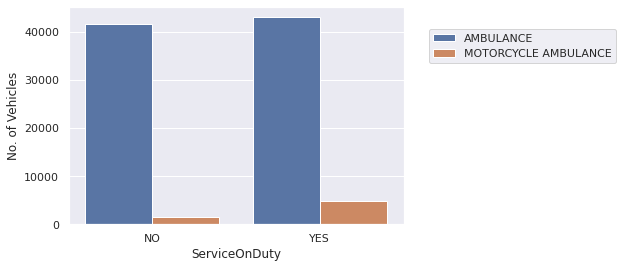

In [51]:
opDF = df.groupby(['emergencyVehicleType','serviceOnDuty'])[['license_plate']].count()
display(opDF)
opDF.reset_index(inplace=True)
opDF
# fig, ax = plt.subplots(figsize=(55,30))
# fig, ax = plt.subplots()

sns.set(font_scale=1)
res = sns.barplot(x='serviceOnDuty',y='license_plate',data = opDF , hue = 'emergencyVehicleType')
res.set(xlabel ="ServiceOnDuty", ylabel = "No. of Vehicles")
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=2)

### 3) Vehicles sorted from increasing to decreasing value w.r.t number of updates in ObservationDateTime (Number of publishes)

In [52]:
# https://www.kite.com/python/answers/how-to-count-unique-values-in-a-pandas-dataframe-group-in-python
grouped_df = df.groupby("license_plate")
grouped_df = grouped_df.agg({"observationDateTime": "nunique"})
grouped_df = grouped_df.sort_values(by=['observationDateTime'], ascending=False).reset_index()
grouped_df.rename(columns = {'observationDateTime':'No. of packets'}, inplace = True)
# display(grouped_df)
fig = px.bar(grouped_df, x=grouped_df.license_plate, y = grouped_df["No. of packets"] )
#               , hover_data=[df.observationDateTime, df.toDateTime, df.publishInterval])
# fig.update_layout(template="plotly_dark")
fig.show()

In [53]:
sub_group = grouped_df[grouped_df['No. of packets']<=500]
sub_group


,license_plate,No. of packets
44,KA02G1615,483
45,KA02G1605,145
46,KA02G1604,84
47,KA02G1616,19
48,KA02G1622,18


In [54]:
### Observing details of vehicles with least number of unique packets .i.e  , less than 500 ###

df1 = sub_group.merge(df, on='license_plate',how='left')
df1.drop(['type'],axis=1,inplace=True)
df1.sort_values(['observationDateTime'],inplace=True)
df1.reset_index(inplace=True)
df1.drop(['index'],axis=1,inplace=True)
df1
df1["emergencyVehicleType"].value_counts()
# df1

MOTORCYCLE AMBULANCE    749
Name: emergencyVehicleType, dtype: int64

In [55]:
df2 = df1.groupby(["license_plate","emergencyVehicleType","serviceOnDuty"])[["id"]].count()
# sns.scatterplot(x="license_plate",y="emergencyVehicleType",data=df1,hue="serviceOnDuty")
df2.rename(columns={"id":"No.of Packets"},inplace=True)
display(df2)
df2.reset_index(inplace=True)
fig = px.scatter(df2, x="license_plate", y="serviceOnDuty", color="emergencyVehicleType", hover_data=['No.of Packets'])
fig.show()

No.of Packets
license_plate emergencyVehicleType serviceOnDuty               
KA02G1604     MOTORCYCLE AMBULANCE NO                         1
                                   YES                       83
KA02G1605     MOTORCYCLE AMBULANCE YES                      145
KA02G1615     MOTORCYCLE AMBULANCE YES                      483
KA02G1616     MOTORCYCLE AMBULANCE NO                        16
                                   YES                        3
KA02G1622     MOTORCYCLE AMBULANCE YES                       18

### 4) Number of Cases handled by each vehicle
(No of switches bet YES and NO for the license plates with lowest and highest count )



In [56]:
def casesHandled(licensePlate):
    df5 = df[df['license_plate'] == licensePlate ].sort_values(by=['observationDateTime'])
    df5['Counter'] = 0
    df5.reset_index(inplace=True)
    df5.drop(['index'], axis=1, inplace=True)
    indices=[]
    for ind in df5.index:
        indices.append(ind)
    for ind in range(0,len(indices)-1):
    #     if df5['serviceOnDuty'].iloc[ind]!= df5['serviceOnDuty'].iloc[ind+1] :
    #          df5['Counter'].iloc[ind+1]+= 1
        if df5['serviceOnDuty'].iloc[ind] == "YES" and df5['serviceOnDuty'].iloc[ind+1] == "NO":
               df5['Counter'].iloc[ind]+= 1        

    return df5['license_plate'].iloc[0], df5['Counter'].sum() 
L7 = list(grouped_df['license_plate'])
res = map(casesHandled,L7)
df7 = pd.DataFrame(list(res))
df7 = df7.rename(columns={0:'license_plate',1:'Cases'})
df7
grouped_df.rename(columns = {'observationDateTime':'No. of packets'}, inplace = True)
grouped_df = grouped_df.merge(df7,on=['license_plate'])
# grouped_df.drop(['Cases_y'],axis=1,inplace = True)
grouped_df.sort_values(by=['No. of packets'],inplace=True, ascending=False)
grouped_df

,license_plate,No. of packets,Cases
0,KA40G514,5865,8
1,KA51G5246,5043,4
2,KA40G473,3830,4
3,KA51G5032,3230,0
4,KA51G5250,3225,6
5,KA51G5242,3067,3
6,KA40G480,3005,5
7,KA51G5234,2862,7
8,KA51G5028,2548,6
9,KA51G5231,2447,5


In [57]:
fig = px.bar(grouped_df, x='license_plate', y='No. of packets',
             hover_data=['Cases'], color='Cases',
             labels={'No. of packets':'No. of packets published'}, height=400)
fig.show()

In [58]:
# df[(df['observationDateTime']>datetime.date(2016,1,1)) & (df['observationDateTime']<datetime.date(2016,3,1))]
# for  df[(df['observationDateTime']==datetime.date(2021,8,23))]

### 5) PUBLISH INTERVAL

In [59]:
def getPublishInterval(license_plate):
        df2 = df[df['license_plate'] == license_plate ].sort_values(by=['observationDateTime'])
        df2["observationDateTime"]=pd.to_datetime(df2["observationDateTime"],errors ='coerce')
        df2.sort_values(by = ["observationDateTime"], inplace=True)

        df2.reset_index(inplace=True)
        df2.drop(["index"],axis=1, inplace=True)

        df2["publishInterval"] = pd.to_timedelta('0 days 00:00:00.0000')
        for i,row in df2.iterrows():
            if i != df2.shape[0]-1:
                df2["publishInterval"][i] = df2["observationDateTime"][i+1] - df2["observationDateTime"][i]

#         df2.groupby('serviceOnDuty')['Publish_Interval'].max()
        
        return df2.groupby('serviceOnDuty').agg({'publishInterval': ['mean', 'min', 'max']})

# getPublishInterval('KA51G5230')
getPublishInterval('KA40G514')
      

publishInterval                                
                                   mean             min             max
serviceOnDuty                                                          
NO            0 days 00:00:10.965304182 0 days 00:00:09 0 days 00:03:18
YES           0 days 00:00:21.633076309 0 days 00:00:00 0 days 10:41:16

In [60]:
##### The packets are being published for every 10 secs if the vehicle is on duty and for every 20 secs if the vehicle is not on duty

In [61]:
# df2 = df[df['license_plate'] == "KA40G514" ].sort_values(by=['observationDateTime'])

# df2["observationDateTime"]=pd.to_datetime(df2["observationDateTime"],errors ='coerce')
# df2.sort_values(by = ["observationDateTime"], inplace=True)
# # df2.info()
# df2.reset_index(inplace=True)
# df2.drop(["index"],axis=1, inplace=True)

# df2["publishInterval"] = pd.to_timedelta('0 days 00:00:00.0000')
# for i,row in df2.iterrows():
#     if i != df2.shape[0]-1:
#         df2["publishInterval"][i] = df2["observationDateTime"][i+1] - df2["observationDateTime"][i]

In [62]:
# df2
# df2.groupby('serviceOnDuty').agg({'publishInterval': ['mean', 'min', 'max']})

### 6) Off Duty Locations

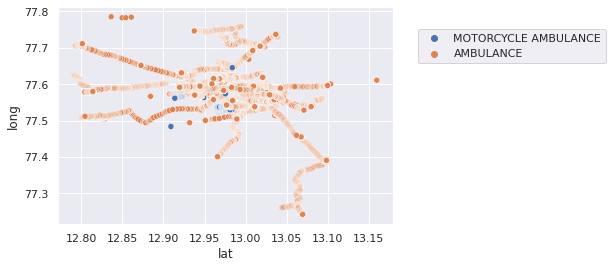

In [63]:
df4 = df[df['serviceOnDuty'] == 'NO'].sort_values(by=['observationDateTime'])
df4 = df4[['license_plate', 'observationDateTime', 'emergencyVehicleType',
       'serviceOnDuty', 'lat', 'long']]
df4.reset_index(inplace = True)
df4.drop(['index'],axis=1, inplace = True)
df4['lat_long'] = df['location'].apply(lambda x: x['coordinates'])
d = df4.groupby(['license_plate']).count()
d[d['lat']<=5]
df4
df4 = df4[['lat', 'long','emergencyVehicleType']].drop_duplicates()

sns.scatterplot(x='lat', y='long' , data=df4 , hue ='emergencyVehicleType')

plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=2)

In [64]:
offDuty_Locations = df4[['lat', 'long','emergencyVehicleType']]
# .sample(100)
offDuty_Locations = offDuty_Locations.values.tolist()
# offDuty_Locations = [ [row["lat"],row["long"]] for i,row in df4.iterrows()]
offDuty_Locations
len(offDuty_Locations)

34954

In [65]:
map_offDuty = folium.Map(location = [12.985486,77.590960],tiles='OpenStreetMap', zoom_start=12)
# folium.vector_layers.PolyLine(offDuty_Locations, popup=None, tooltip=None).add_to(map_line)
marker_cluster = folium.plugins.MarkerCluster().add_to(map_offDuty)
# folium.vector_layers.Circle(offDuty_Locations,radius=50, popup=None, tooltip=None).add_to(map_offDuty)
a = [ folium.Marker(i[0:2], popup=i[2]).add_to(marker_cluster) for i in offDuty_Locations ]
    
map_offDuty

### 7) Vehicles on Service yet with No Location info

In [66]:
df6 = df[(df['lat']==0) & (df["serviceOnDuty"]=="YES")]
df6 = df6.groupby(["emergencyVehicleType","serviceOnDuty"])[["id"]].count()
df6.rename(columns={"id":"Packet Count"},inplace = True)
df6

,,Packet Count
emergencyVehicleType,serviceOnDuty,
MOTORCYCLE AMBULANCE,YES,22


### 8) Day-Wise On-Duty and Off-Duty Vehicle Count

In [67]:
# daywise = df.groupby(['Date','serviceOnDuty'])[['license_plate']].count()
# daywise

In [68]:
# def getElements(L1):
#     L = [i for i in L1]

In [69]:
# # daywise = df.groupby(["license_plate",'Date']).agg({"id": "count","license_plate":"unique"})
# # daywise = daywise.groupby(by=["Date"]).agg({"id": "count","license_plate":"unique"})
# daywise = df.groupby(["license_plate",'Date'])[['id']].count().sort_values(["id"],ascending=False).reset_index()
# daywise = daywise.groupby(by=["Date"])[["id"]].count().sort_values(["id"],ascending=False).reset_index()
# daywise

In [70]:
daywise = df.groupby(['Date','serviceOnDuty',"license_plate"])[['id']].count()
daywise.drop(["id"],axis=1,inplace=True)
daywise.reset_index(inplace=True)
daywise = daywise.groupby(["Date","serviceOnDuty"])[["license_plate"]].count()
daywise.rename(columns={"license_plate":"Vehicle Count"},inplace=True)
daywise.reset_index(inplace=True)
daywise

,Date,serviceOnDuty,Vehicle Count
0,2021-09-23,NO,42
1,2021-09-23,YES,38
2,2021-09-24,NO,44
3,2021-09-24,YES,44


In [71]:
fig = px.bar(daywise, x="Date", y="Vehicle Count", color="serviceOnDuty")
fig.show()

### 9) REGION OF TRAVEL
##### ( Plot focussing Bangalore City)

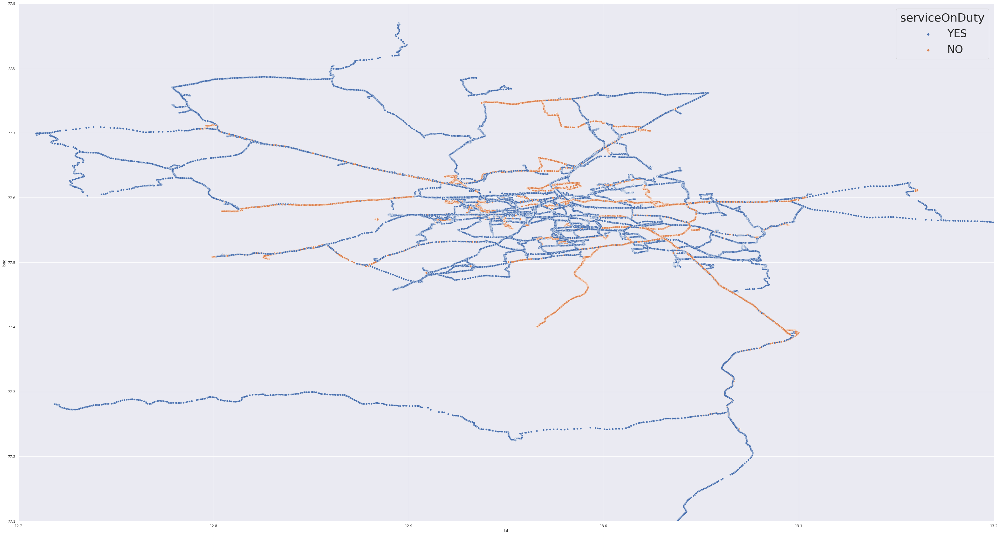

In [72]:
fig, ax = plt.subplots(figsize=(55,30))
# fig, ax = plt.subplots()

sns.set(font_scale=3)

sns.scatterplot(x='lat',y='long',data=df ,  ax=ax ,hue='serviceOnDuty')

ax.set_xlim(12.7,13.2)
ax.set_ylim(77.1,77.9)

# ax.set_xticks(range(1,32))
plt.show()

In [73]:
print("Latitude Range --- ", df[df['lat']>0]['lat'].min(),":",df['lat'].max())
print("Longitude Range --- ", df[df['long']>0]['long'].min(),":",df['long'].max())

Latitude Range ---  12.709094 : 13.312838
Longitude Range ---  77.08284 : 77.869438


### 10) Route Travelled by a particular Vehicle

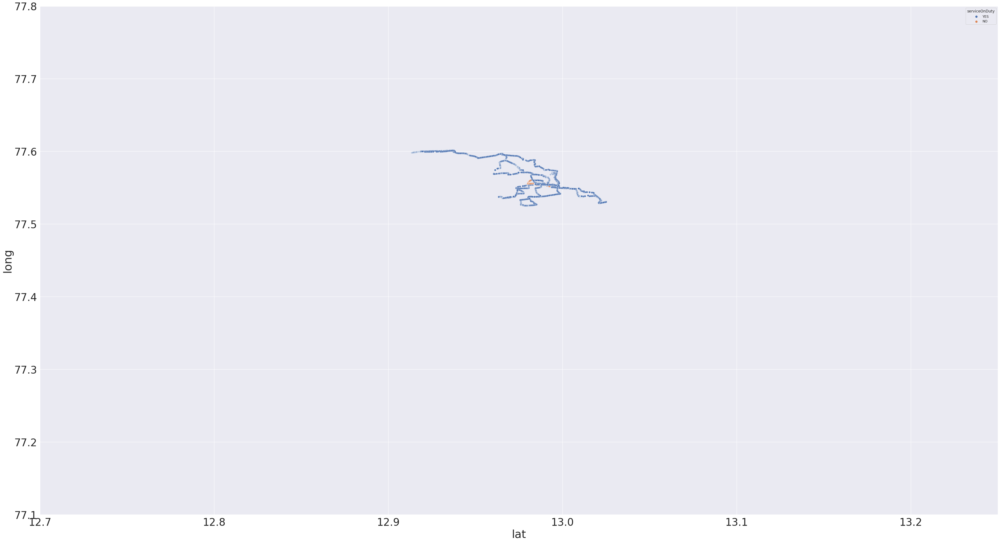

In [74]:
# Region of travel for one particular vehicle
def plotTravelRoute(license_plate):
        vehicle = df[df['license_plate'] == license_plate ]
        fig, ax = plt.subplots(figsize=(55,30))
        
        sns.set(font_scale=1)
        sns.scatterplot(x='lat',y='long',data=vehicle ,  ax=ax ,hue='serviceOnDuty')
#         sns.catplot(x='lat',y='long',data=vehicle,col='serviceOnDuty',hue='emergencyVehicleType', split = True )

        ax.set_xlim(12.7,13.25)
        ax.set_ylim(77.1,77.8)

        # ax.set_xticks(range(1,32))       
        plt.show()
                
plotTravelRoute('KA40G514')

In [75]:
df8 = df[df["license_plate"]=="KA40G514"].reset_index().drop(["index"],axis=1)
vehicle_trace = [ [row["lat"],row["long"] ]  for i,row in df8.iterrows()]


In [76]:
map_travel_route = folium.Map(location = [12.9812,77.5828],tiles='OpenStreetMap', zoom_start=12)
folium.vector_layers.PolyLine(vehicle_trace, popup=None, tooltip=None , weight=3, color="blue").add_to(map_travel_route)
map_travel_route.add_child(folium.LatLngPopup())
map_travel_route

### 11) REGION OF TRAVEL BY  EMERGENCY VEHICLE TYPE

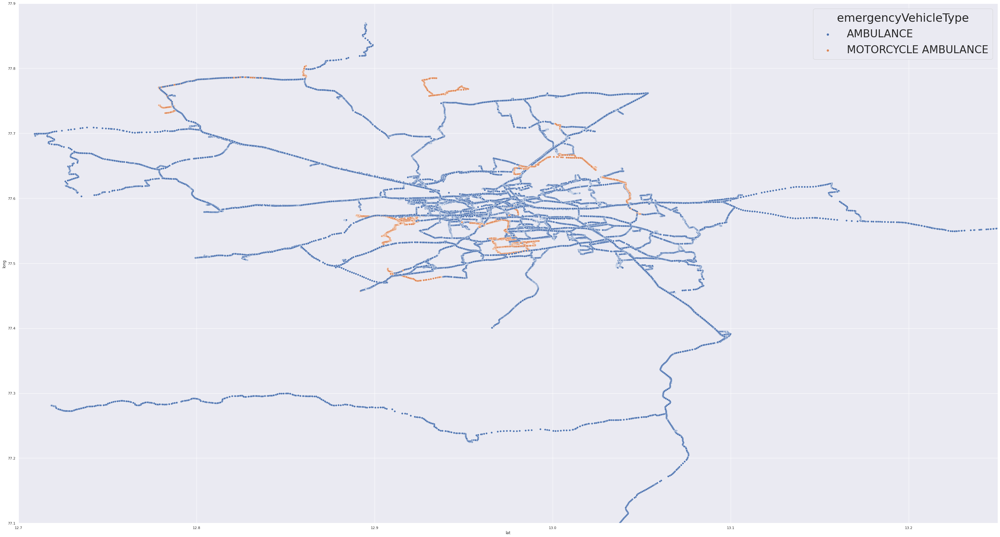

In [77]:
fig, ax = plt.subplots(figsize=(55,30))
# fig, ax = plt.subplots()

sns.set(font_scale=3)

sns.scatterplot(x='lat',y='long',data=df ,  ax=ax ,hue='emergencyVehicleType')

ax.set_xlim(12.7,13.25)
ax.set_ylim(77.1,77.9)

# ax.set_xticks(range(1,32))
plt.show()

In [78]:
# df8 = df[df["license_plate"].isin("KA40G514",)].reset_index().drop(["index"],axis=1)
df8 = df[df["emergencyVehicleType"] == "AMBULANCE"]
amb_vehicle_trace = [ [row["lat"],row["long"]]  for i,row in df8.iterrows()]
motoramb_vehicle_trace = [ [row["lat"],row["long"]]  for i,row in df[df["emergencyVehicleType"] == "MOTORCYCLE AMBULANCE"].iterrows()]
# cMap = {"AMBULANCE":"blue",
#         "MOTORCYCLE AMBULANCE":"pink"}

In [79]:
map_route_vehicleType = folium.Map(location = [12.9812,77.5828],tiles='OpenStreetMap', zoom_start=12)
# a = [ folium.Marker(i[0:2], popup=i[2],icon=folium.Icon(icon="location-pin",color=cMap[i[2]], prefix="fa")).add_to(map_route_vehicleType) for i in vehicle_trace ]
folium.vector_layers.PolyLine(amb_vehicle_trace, popup=None, tooltip=None , weight=1, color="blue").add_to(map_route_vehicleType)
folium.vector_layers.PolyLine(motoramb_vehicle_trace, popup=None, tooltip=None , weight=1, color="pink").add_to(map_route_vehicleType)

map_route_vehicleType.add_child(folium.LatLngPopup())
map_route_vehicleType

In [80]:
# vehicle = df[df['license_plate'] == 'KA40G514' ]
# fig, ax = plt.subplots(figsize=(55,30))
# # fig, ax = plt.subplots()

# sns.set(font_scale=3)

# sns.scatterplot(x='lat',y='long',data=vehicle ,  ax=ax ,hue='emergencyVehicleType')

# ax.set_xlim(12.7,13.25)
# ax.set_ylim(77.1,77.9)

# # ax.set_xticks(range(1,32))
# plt.show()